In [1]:
import os
import numpy as np
import pandas as pd
import cv2


from skimage.io import imread
from skimage.transform import resize,rotate
from skimage.measure import find_contours
from skimage.util import invert
from skimage.color import rgb2gray
import matplotlib.pyplot as plt
plt.style.use('default')

import keras.backend as K
import keras
from keras import layers, activations
from keras.models import Model
from keras.preprocessing.image import load_img,img_to_array
from keras.utils.vis_utils import plot_model
from keras.engine.topology import Layer

from IPython.display import Image
import tensorflow as tf

import yaml

Using TensorFlow backend.


In [3]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
 def get_classes_from_ranges(wOc):
  if(wOc<=ranges[0]):
        return 0
  for i in range(len(ranges)):
    if(i==(len(ranges)-1)):
      return i+1
    if(wOc>ranges[i] and wOc<=ranges[i+1]):
      return i+1

def get_images(path,prefix,indexs):
  arr=[]
  arr_of_files=[ str(x).zfill(3)+prefix for x in indexs]
  for img_pth in arr_of_files:
    img = cv2.imread(path+img_pth)
    # img=cv2.resize(img, (100,100))
    arr.append(img)

  return np.array(arr)

def plot_ranges(arr):
  plt.figure(figsize=(5,30))
  for i in range(len(arr)+1):
    if i==0:
      uplimit=arr[i]
      downlimit="_"
    elif i==len(arr):
      downlimit=arr[i-1]
      uplimit="_"
    else:
      downlimit=arr[i-1]
      uplimit=arr[i]
    plt.subplot(len(arr)+1,1,i+1)
    plot_wOc(uplimit=uplimit,downlimit=downlimit)

def plot_wOc(downlimit="_",uplimit="_"):
  temp=w_c
  if uplimit!="_":
    temp=w_c[w_c["w/c"]<uplimit]
  if downlimit!="_":
    temp=temp[w_c["w/c"]>=downlimit]
  temp["w/c"].hist()
  plt.title(str(downlimit)+"<w/c<"+str(uplimit)+"          "+str(len(temp)/len(w_c)))


def predict(n,arr_x,arr_y,model,thsd_g,thsd_r,indx):

  prediction = model.predict(arr_x[n:n+1])
  prediction = np.reshape(prediction,(dim,dim,3))

  g=prediction[:,:,1]>thsd_g
  g=g*1

  r=prediction[:,:,0]>thsd_r
  r=r*1

  green_count=np.sum(g.reshape(-1))
  red_count=np.sum(r.reshape(-1))

  wOc=red_count/(red_count+green_count)
  cls=get_classes_from_ranges(wOc)

  plt.figure(figsize=(10,8))
  plt.subplot(2,3,1)
  plt.title("input")
  plt.imshow(arr_x[n])

  correct_class=w_c.loc[indx]["classes"]
  print(indx,"indx")
  print(correct_class)
  plt.subplot(2,3,2)
  plt.title("correct_output_label,class"+str(correct_class))
  img = np.reshape(arr_y[n, :],(dim,dim,3))
  plt.imshow(img)

  plt.subplot(2,3,3)
  plt.title("prediction_raw,class:"+str(cls))
  plt.imshow(prediction)

  plt.subplot(2,3,4)
  plt.title("weed")
  plt.imshow(r)

  plt.subplot(2,3,5)
  plt.title("crop")
  plt.imshow(g)


  


  return red_count,green_count,cls


#get the classes of all the data
def get_classes_all_data():
  indxs=[i for i in range(1,61)]
  red_count=[]
  green_count=[]


  for number in indxs:

      number = "{0:03d}".format(number)


      

      y_path = os.path.join('.',"annotations",str(number)) + "_annotation.png" 
      img = load_img(y_path)
      img = img_to_array(img)/255
      
      weed = img[:,:,0]
      crop = img[:,:,1]

      red_count.append(np.sum(weed))
      green_count.append(np.sum(crop))
  df=pd.DataFrame()
  df["weed"]=red_count
  df["crop"]=green_count
  df["w/c"]=df["weed"]/(df["weed"]+df["crop"])
  return df


 #get the classes of the model predictions    
 def get_classes(x,y,is_test=True):
  classes=[]
  if is_test:
    indexes=test_indx
  else:
    indexes=train_indx
  for i in range(len(y)):
    red_count,green_count,cls= predict(i,x,y,model,thsd_g=0.7,thsd_r=0.7,indx=indexes[i]-1)
    classes.append(cls)
  return classes
   


In [0]:
!cp -r ./drive/'My Drive'/'dataset-master'/images ./
!cp -r ./drive/'My Drive'/'dataset-master'/annotations ./

In [0]:
# !cp -r ./drive/'My Drive'/'dataset-master'/masks ./

In [0]:
train_indx= [2, 5, 6, 7, 8, 11, 12, 14, 16, 17, 18, 19, 20, 23, 24, 25, 27, 28, 31, 33, 34, 36, 37, 38, 40, 41, 42, 43, 45, 46, 49, 50, 51, 52, 53, 55, 56, 57, 58, 59]
test_indx= [1, 3, 4, 9, 10, 13, 15, 21, 22, 26, 28, 29, 30, 32, 35, 39, 44, 47, 48, 54, 60]
train_indx=np.array(train_indx)
test_indx=np.array(test_indx)

In [0]:
w_c=get_classes_all_data()
ranges=[0.2,0.4,0.6]
w_c["classes"]=w_c["w/c"].apply(get_classes_from_ranges)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:40: UserWarning: Boolean Series key will be reindexed to match DataFrame index.


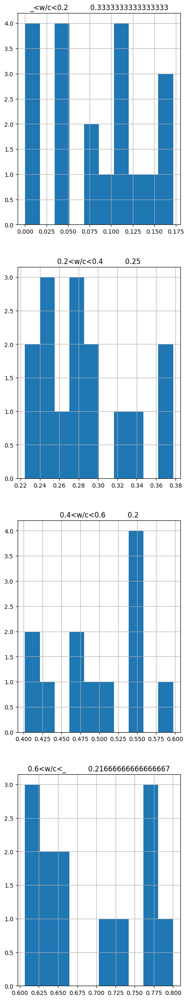

In [9]:
plot_ranges(ranges)

In [10]:
#read image into memory

train_x = []
train_y = []
test_x = []
test_y = []

dim=1024

for number in train_indx:

    number = "{0:03d}".format(number)

    x_path = os.path.join('.',"images",str.format(number)) + "_image.png" 
    img = load_img(x_path,target_size=(dim,dim))
    img = img_to_array(img)/255
    train_x.append(img)
    

    y_path = os.path.join('.',"annotations",str(number)) + "_annotation.png" 
    img = load_img(y_path,target_size=(dim,dim))
    img = img_to_array(img)/255
    
    weed = img[:,:,0]
    crop = img[:,:,1]

    y = np.zeros((dim,dim,3))
    y[:,:, 0] = weed
    y[:, :, 1] = crop
    
    back = img.copy()
    back = np.all(img == [0, 0, 0],axis=-1)*1
    y[:,:, 2] = back
    
    y = np.reshape(y,(dim*dim,3))
    
    train_y.append(y)
    
    
for number in test_indx:
    number = "{0:03d}".format(number)

    x_path = os.path.join(".","images",str.format(number)) + "_image.png" 
    img = load_img(x_path,target_size=(dim,dim))
    img = img_to_array(img)/255
    test_x.append(img)
    
    y_path = os.path.join(".","annotations",str(number)) + "_annotation.png" 
    img = load_img(y_path,target_size=(dim,dim))
    img = img_to_array(img)/255
    
    weed = img[:,:,0]
    crop = img[:,:,1]

    y = np.zeros((dim,dim,3))
    
    y[:,:, 0] = weed
    y[:, :,1] = crop

    back = img.copy()
    back = np.all(img == [0, 0, 0],axis=-1)*1
    y[:,:, 2] = back
    
    y = np.reshape(y,(dim*dim,3))
    test_y.append(y)

    
train_x = np.array(train_x)
train_y = np.array(train_y)
test_x = np.array(test_x)
test_y = np.array(test_y)

#check shape
print(train_x.shape)
print(train_y.shape)
print(test_x.shape)
print(test_y.shape)


(40, 1024, 1024, 3)
(40, 1048576, 3)
(21, 1024, 1024, 3)
(21, 1048576, 3)


In [0]:
def small_Unet(labels=1,h=128,w=128, out_activation = "sigmoid"):
    
    class MySoftmax(Layer):
        #http://cookie-box.hatenablog.com/entry/2017/08/15/231503 
        def __init__(self, **kwargs):
            super(MySoftmax, self).__init__(**kwargs)
        def call(self, x):
            return(activations.softmax(x, axis=3))

    
    
    #block1, 128x128
    inputs = layers.Input(shape=(h,w,3))
    conv11 = layers.Conv2D(16,(3,3),activation="relu",padding="same")(inputs)
    conv12= layers.Conv2D(16,(3,3),activation="relu",padding="same")(conv11)
    conv13= layers.Conv2D(16,(3,3),activation="relu",padding="same")(conv12)
    pool1 = layers.MaxPool2D((2,2))(conv13)
    drop1 = layers.Dropout(0.5)(pool1)
   #block2 64x64
    conv21 = layers.Conv2D(32,(3,3),activation="relu",padding="same")(drop1)
    conv22 = layers.Conv2D(32,(3,3),activation="relu",padding="same")(conv21)
    conv23 = layers.Conv2D(32,(3,3),activation="relu",padding="same")(conv22)
    pool2 = layers.MaxPool2D((2,2))(conv23)
    drop2 = layers.Dropout(0.5)(pool2)
    #block3 32x32
    conv31 = layers.Conv2D(64,(3,3),activation="relu",padding="same")(drop2)
    conv32 = layers.Conv2D(64,(3,3),activation="relu",padding="same")(conv31)
    conv33 = layers.Conv2D(64,(3,3),activation="relu",padding="same")(conv32)
    pool3 = layers.MaxPool2D((2,2))(conv33)
    drop3 = layers.Dropout(0.5)(pool3)

    #block4 16x16
    conv41 = layers.Conv2D(128,(3,3),activation="relu",padding="same")(drop3)
    conv42 = layers.Conv2D(128,(3,3),activation="relu",padding="same")(conv41)
    conv43 = layers.Conv2D(128,(3,3),activation="relu",padding="same")(conv42)
    pool4 = layers.MaxPool2D((2,2))(conv43)
    drop4 = layers.Dropout(0.5)(pool4)
    
    #bottom of Unet 8x8
    conv5 = layers.Conv2D(256,(3,3),activation="relu",padding="same")(drop4)
    conv5 = layers.Conv2D(256,(3,3),activation="relu",padding="same")(conv5)

    #upblock4
    x = layers.UpSampling2D((2,2))(conv5)
    x = layers.Conv2D(128,(3,3),activation="relu",padding="same")(x)
    x = layers.concatenate([conv43,x])
    x= layers.Conv2D(128,(3,3),activation="relu",padding="same")(x)
    x = layers.Conv2D(128,(3,3),activation="relu",padding="same")(x)
    x = layers.Dropout(0.5)(x)
    #upblock3
    x = layers.UpSampling2D((2,2))(x)
    x = layers.Conv2D(64,(3,3),activation="relu",padding="same")(x)
    x = layers.concatenate([conv33,x])
    x= layers.Conv2D(64,(3,3),activation="relu",padding="same")(x)
    x= layers.Conv2D(64,(3,3),activation="relu",padding="same")(x)
    x = layers.Dropout(0.5)(x)
    #upblock2
    x = layers.UpSampling2D((2,2))(x)
    x = layers.Conv2D(32,(3,3),activation="relu",padding="same")(x)
    x = layers.concatenate([conv23,x])
    x= layers.Conv2D(32,(3,3),activation="relu",padding="same")(x)
    x= layers.Conv2D(32,(3,3),activation="relu",padding="same")(x)
    x = layers.Dropout(0.5)(x)
    #upblock1
    x = layers.UpSampling2D((2,2))(x)
    x = layers.Conv2D(16,(3,3),activation="relu",padding="same")(x)
    x = layers.concatenate([conv13,x])
    x= layers.Conv2D(16,(3,3),activation="relu",padding="same")(x)
    x= layers.Conv2D(16,(3,3),activation="relu",padding="same")(x)
    x = layers.Dropout(0.5)(x)
    #to label image (2 labels)
    x = layers.Conv2D(labels,(1,1))(x)
    if out_activation == "sigmoid":
        outputs = layers.Activation("sigmoid")(x)
    elif out_activation == "softmax":
        outputs =MySoftmax()(x)
    elif  out_activation == None:
        outputs = x
    model = Model(inputs=inputs,outputs=outputs)
    return model

1121417.91015625
2122541.19140625
38652408


Text(0, 0.5, 'px')

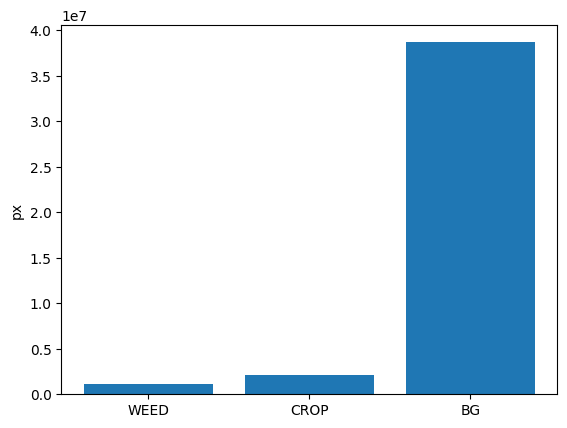

In [12]:
# calculate total pixel per label in train dataset

weed_pixel = 0
crop_pixel = 0
background_pixel = 0

for number in train_indx:

    number = "{0:03d}".format(number)

    y_path = os.path.join(".","annotations",str(number)) + "_annotation.png" 
    img = load_img(y_path,target_size=(dim,dim))
    img = img_to_array(img)/255

    weed = img[:,:,0]
    _pixel = np.sum(weed.flatten())
    weed_pixel += _pixel 
    crop = img[:,:,1]
    _pixel = np.sum(crop.flatten())
    crop_pixel += _pixel

    back = img.copy()
    back = np.all(img == [0, 0, 0],axis=-1) * 1
    _pixel = np.sum(back.flatten())
    background_pixel += _pixel


print(weed_pixel)
print(crop_pixel)
print(background_pixel)

plt.bar(["WEED","CROP","BG"],[weed_pixel,crop_pixel,background_pixel])
plt.ylabel("px")

In [13]:
class_weight = [background_pixel/weed_pixel, background_pixel/crop_pixel, 1]
print(class_weight)


[34.467443091411354, 18.21043952244412, 1]


In [0]:
#categorical crossentropy with losses
#https://forums.fast.ai/t/unbalanced-classes-in-image-segmentation/18289/2
def weighted_categorical_crossentropy(weights):
    """ weighted_categorical_crossentropy

        Args:
            * weights<ktensor|nparray|list>: crossentropy weights
        Returns:
            * weighted categorical crossentropy function
    """
    if isinstance(weights,list) or isinstance(np.ndarray):
        weights=K.variable(weights)

    def loss(target,output,from_logits=False):
        if not from_logits:
            output /= tf.reduce_sum(output,
                                    len(output.get_shape()) - 1,
                                    True)
            _epsilon = tf.convert_to_tensor(K.epsilon(), dtype=output.dtype.base_dtype)
            output = tf.clip_by_value(output, _epsilon, 1. - _epsilon)
            weighted_losses = target * tf.log(output) * weights
            return - tf.reduce_sum(weighted_losses,len(output.get_shape()) - 1)
        else:
            raise ValueError('WeightedCategoricalCrossentropy: not valid with logits')
    return loss   

In [0]:
from keras.callbacks import EarlyStopping
from keras.callbacks import ReduceLROnPlateau
from keras.callbacks import ModelCheckpoint
es = EarlyStopping(monitor='val_loss', patience=20)
# mcp_save = ModelCheckpoint('.mdl_wts.hdf5', save_best_only=True, monitor='val_loss')
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=10, verbose=1, epsilon=1e-4)



In [0]:
K.clear_session()

custom_loss = weighted_categorical_crossentropy(class_weight)

unet = small_Unet(labels=3,out_activation=None,h=dim,w=dim)  
l = layers.Reshape((dim*dim,3))(unet.output)
outs = layers.Activation("softmax")(l)

model = Model(inputs=unet.input,outputs=outs)

model.compile(loss=custom_loss,optimizer="adam")

In [0]:
history = model.fit(train_x, train_y, batch_size=1, epochs=550, verbose=1,validation_data=(test_x[:11],test_y[:11]),callbacks=[es,reduce_lr_loss])

In [0]:
import matplotlib.pyplot as plt
loss = history.history['loss']
val_loss = history.history['val_loss']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation lossuracy')
plt.legend()
plt.show()

In [0]:

# !rm ./model.json
# !rm ./model.h5
# !rm ./drive/'My Drive'/saved_models/model.json
# !rm ./drive/'My Drive'/saved_models/model.h5
# model_json = model.to_json()
# with open("model.json", "w") as json_file:
#     json_file.write(model_json)
# # serialize weights to HDF5
# model.save_weights("model.h5")
# print("Saved model to disk")
# !cp ./model.json ./drive/'My Drive'/saved_models
# !cp ./model.h5 ./drive/'My Drive'/saved_models

In [0]:
!cp -r ./drive/'My Drive'/saved_models/ .

In [0]:
import json
from tensorflow.keras.models import model_from_json
with open('saved_models/model_in_json.json','r') as f:
    model_json = json.load(f) 

model = model_from_json(model_json)
model.load_weights('saved_models/model_weights.h5')


0 indx
1.0
2 indx
2.0
3 indx
1.0
8 indx
0.0
9 indx
0.0
12 indx
1.0
14 indx
2.0
20 indx
0.0
21 indx
0.0
25 indx
3.0
27 indx
0.0
28 indx
1.0
29 indx
2.0
31 indx
0.0
34 indx
0.0
38 indx
3.0
43 indx
2.0
46 indx
3.0
47 indx
0.0
53 indx
3.0


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


59 indx
2.0


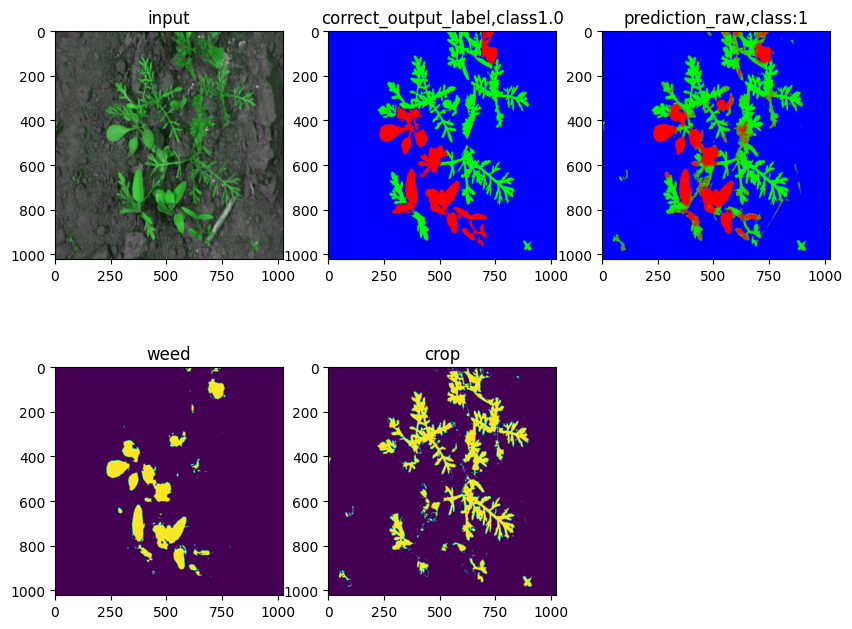

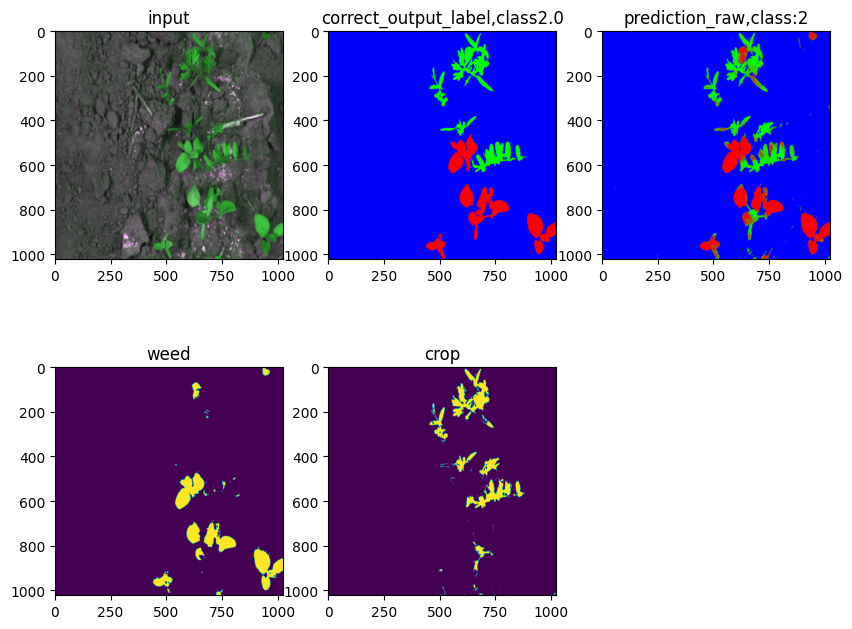

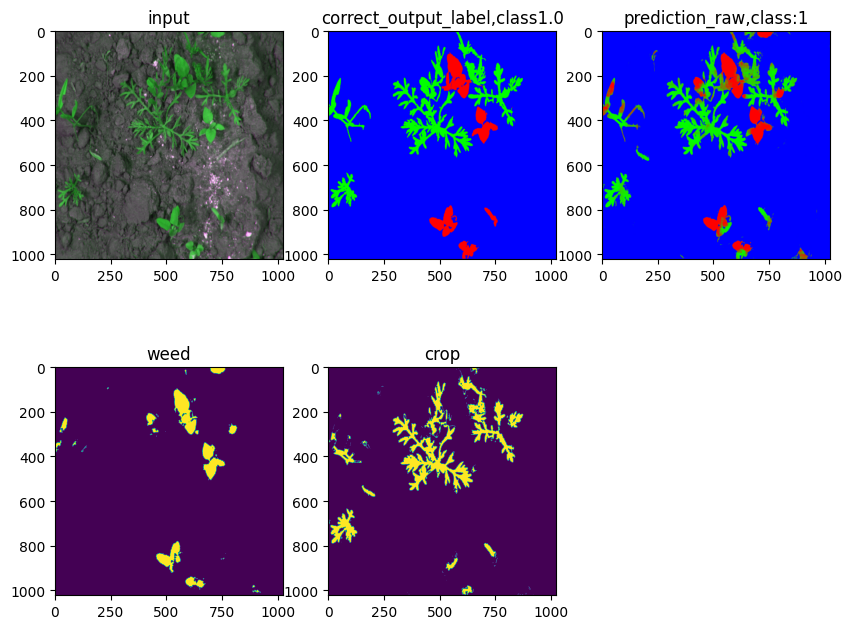

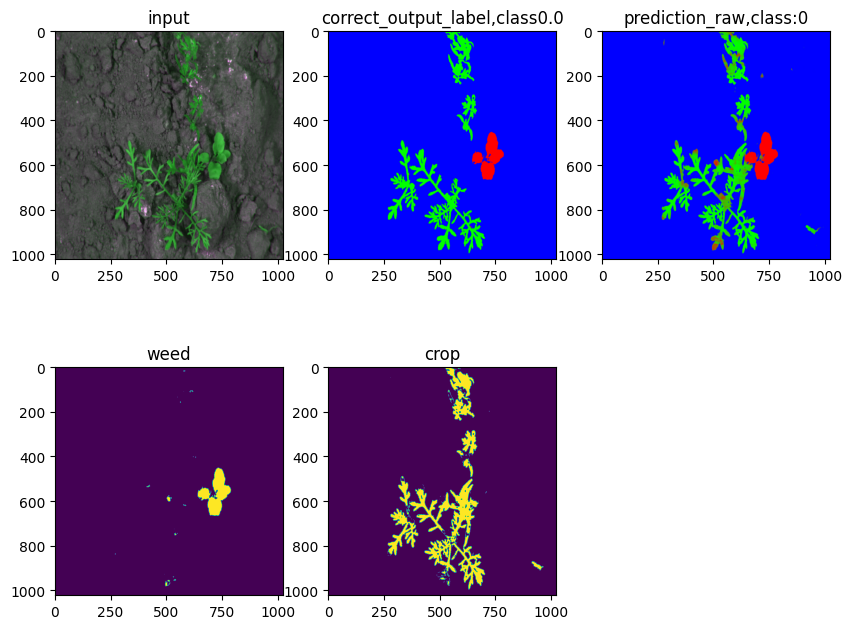

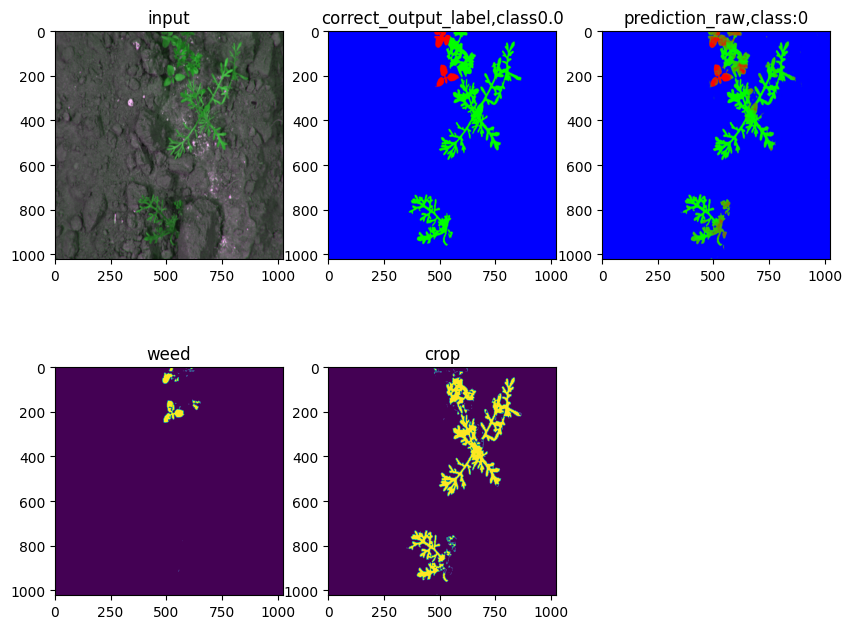

...

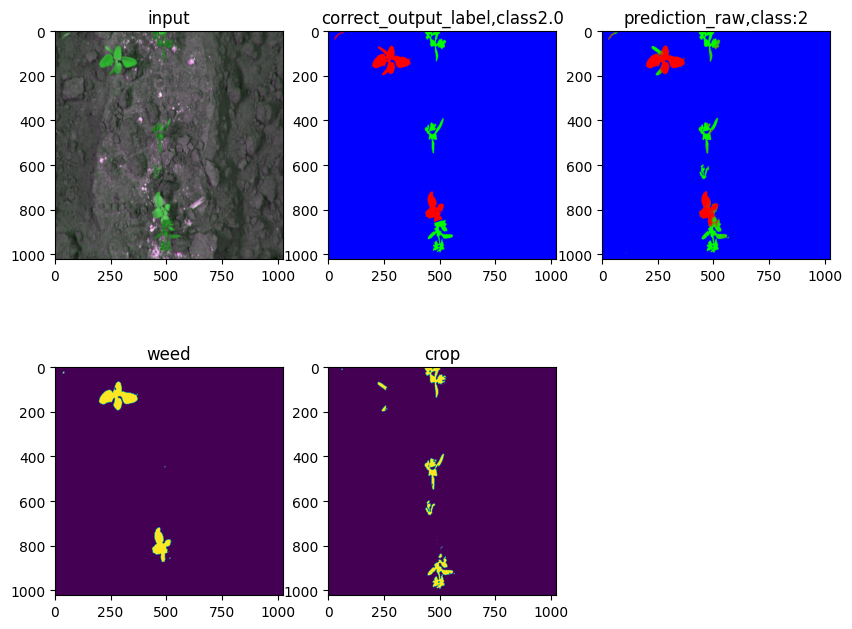

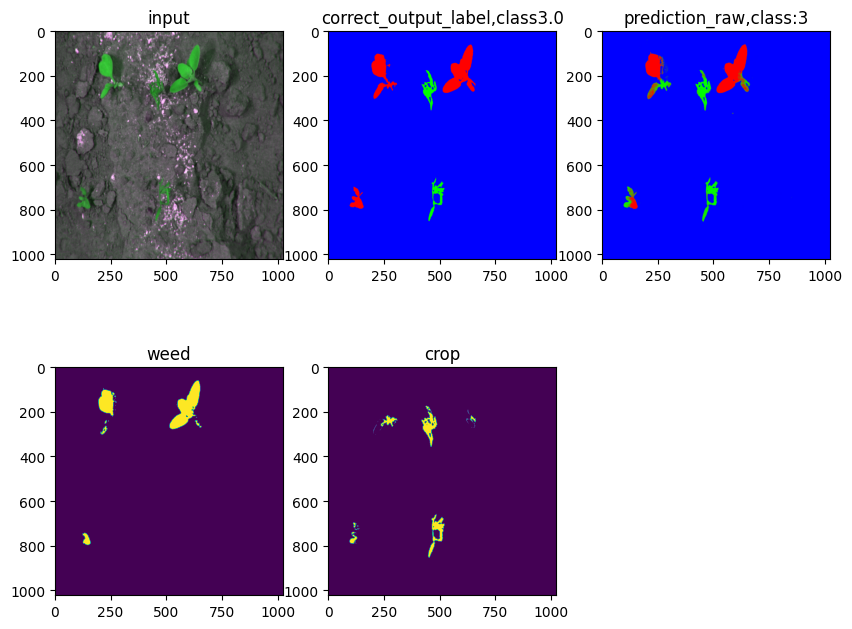

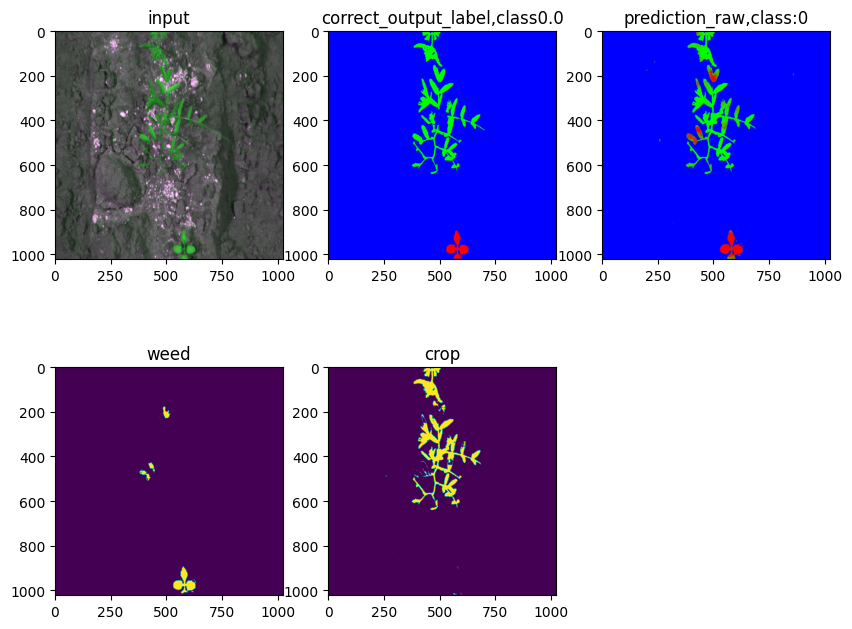

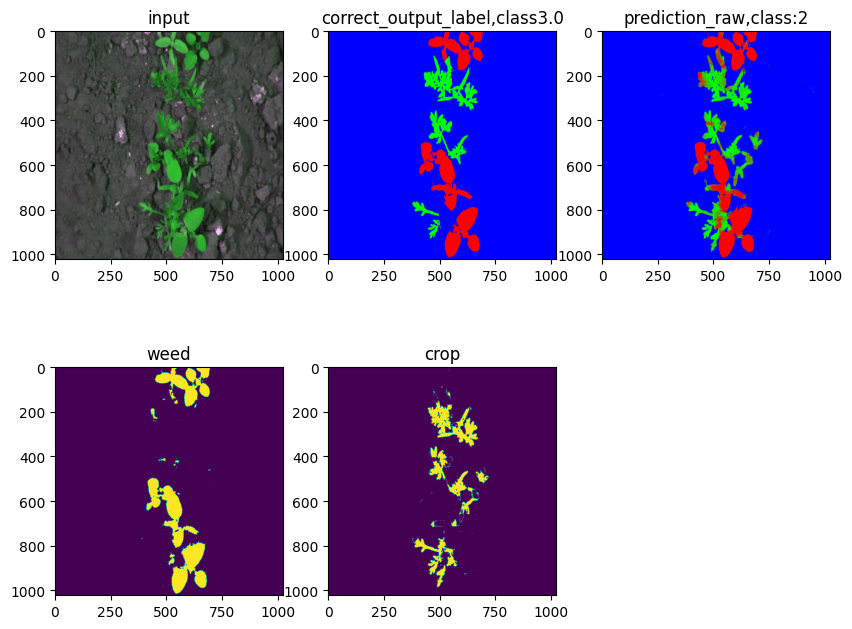

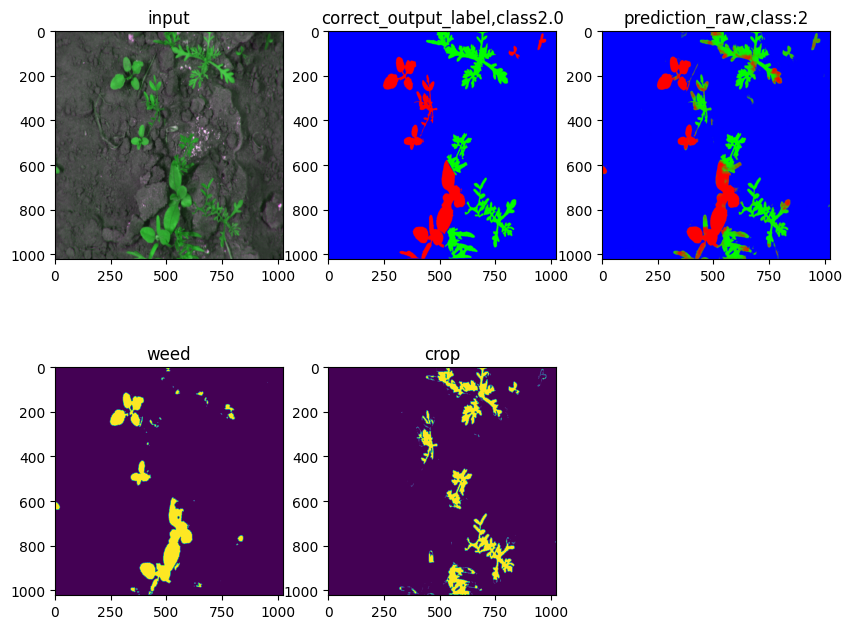

In [31]:
classes_test=get_classes(test_x,test_y)

1 indx
1.0
4 indx
2.0
5 indx
1.0
6 indx
0.0
7 indx
0.0
10 indx
0.0
11 indx
0.0
13 indx
2.0
15 indx
1.0
16 indx
2.0
17 indx
2.0
18 indx
0.0
19 indx
1.0
22 indx
1.0
23 indx
0.0
24 indx
0.0
26 indx
0.0
27 indx
0.0
30 indx
3.0
32 indx
3.0
33 indx
0.0


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


35 indx
3.0
36 indx
1.0
37 indx
2.0
39 indx
1.0
40 indx
0.0
41 indx
3.0
42 indx
3.0
44 indx
1.0
45 indx
3.0
48 indx
1.0
49 indx
0.0
50 indx
0.0
51 indx
1.0
52 indx
3.0
54 indx
1.0
55 indx
3.0
56 indx
2.0
57 indx
3.0
58 indx
2.0


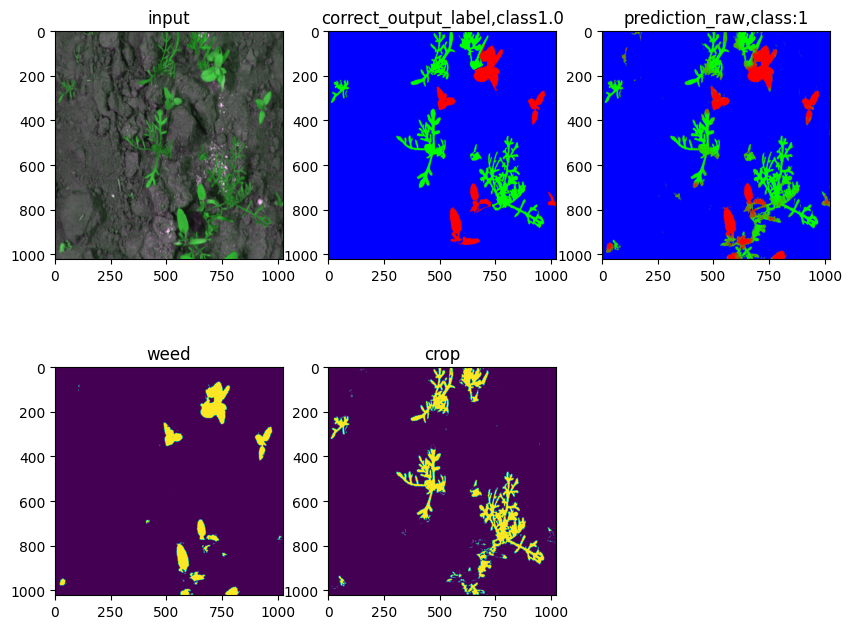

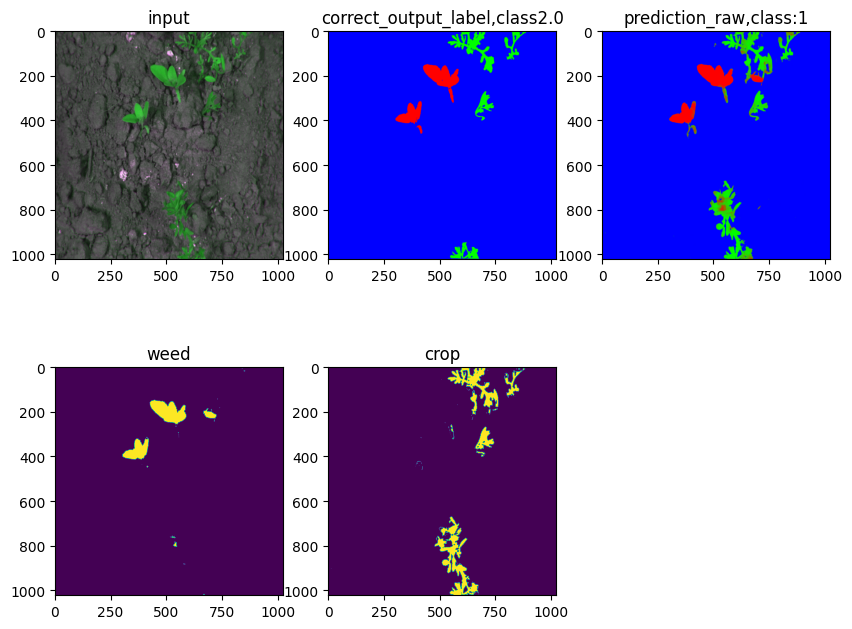

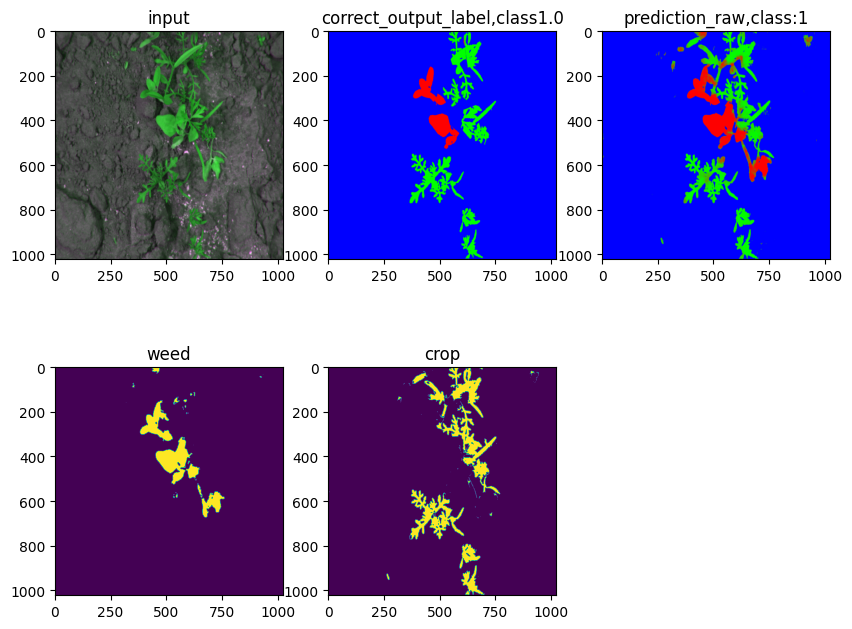

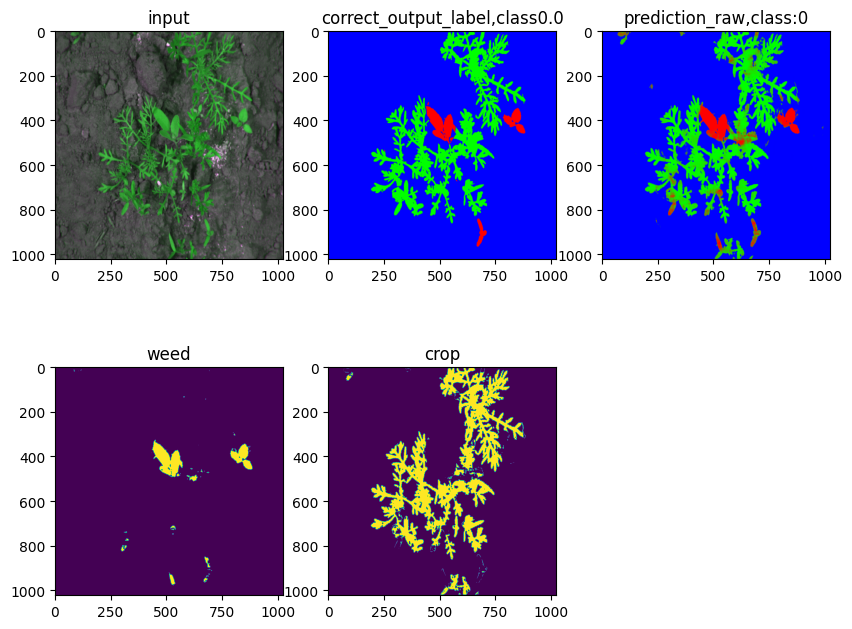

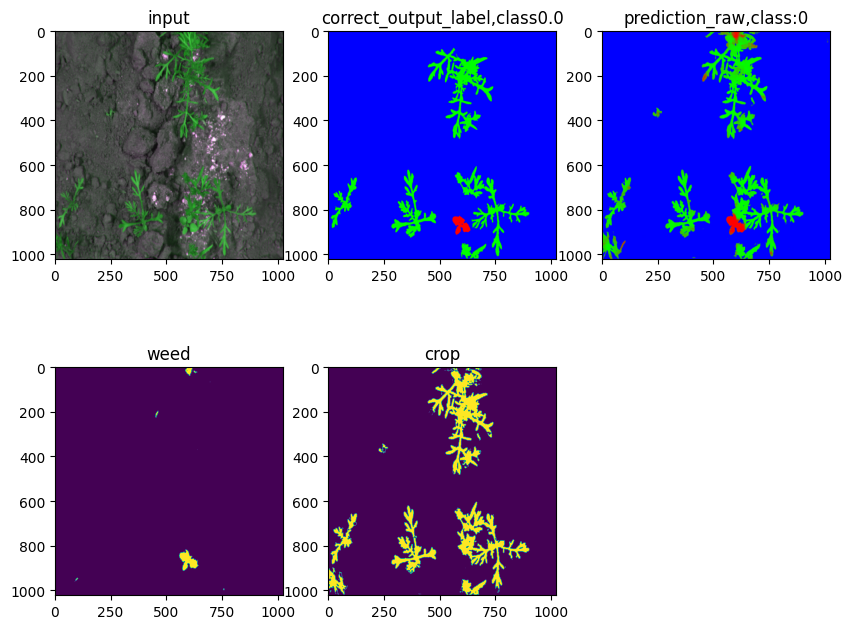

...

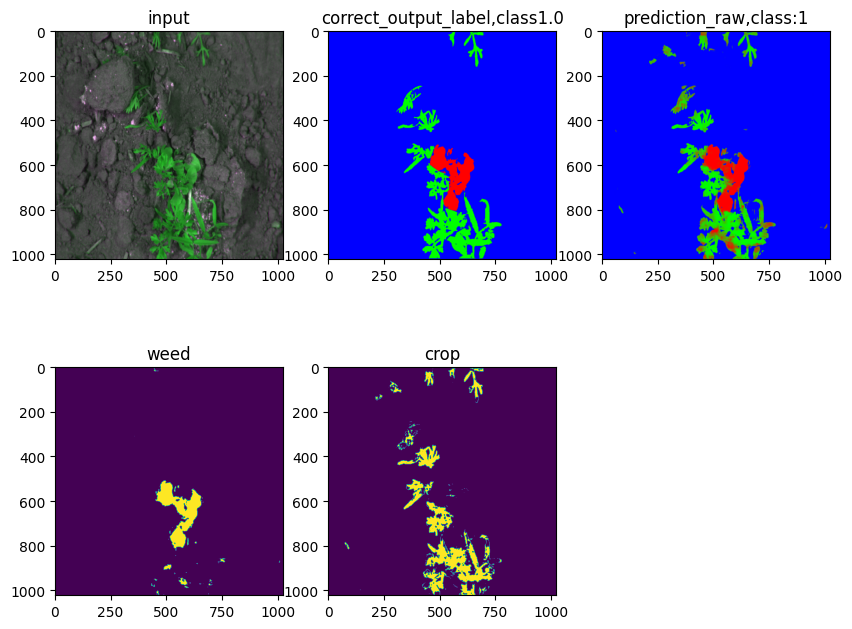

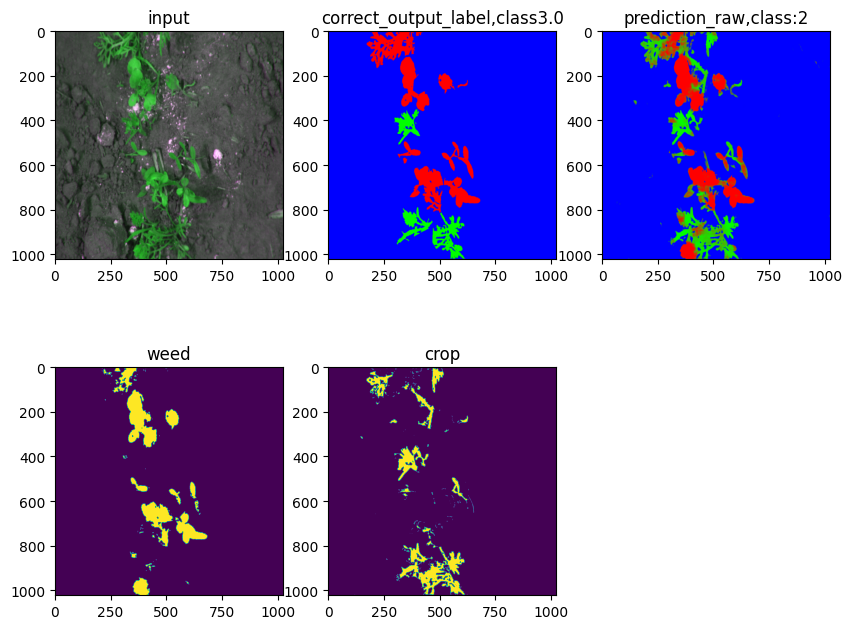

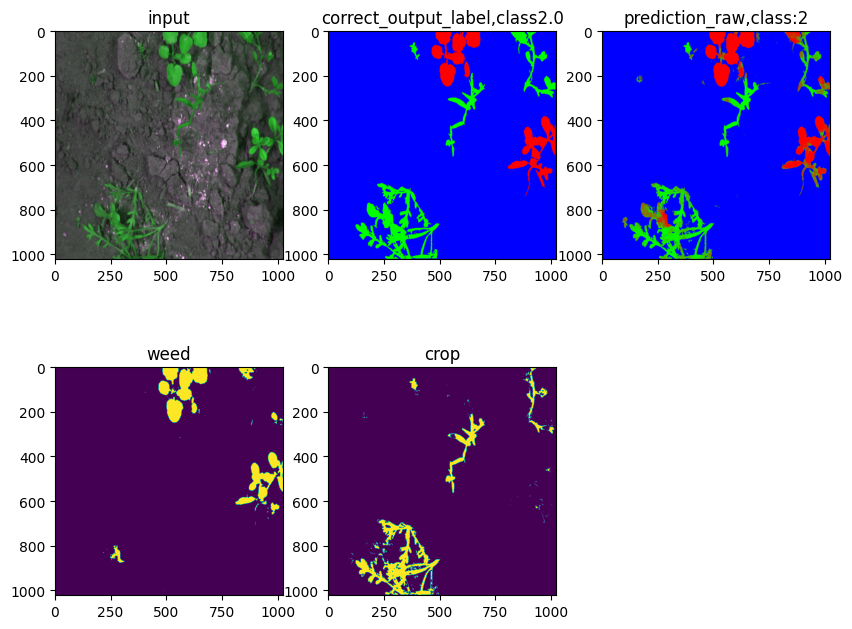

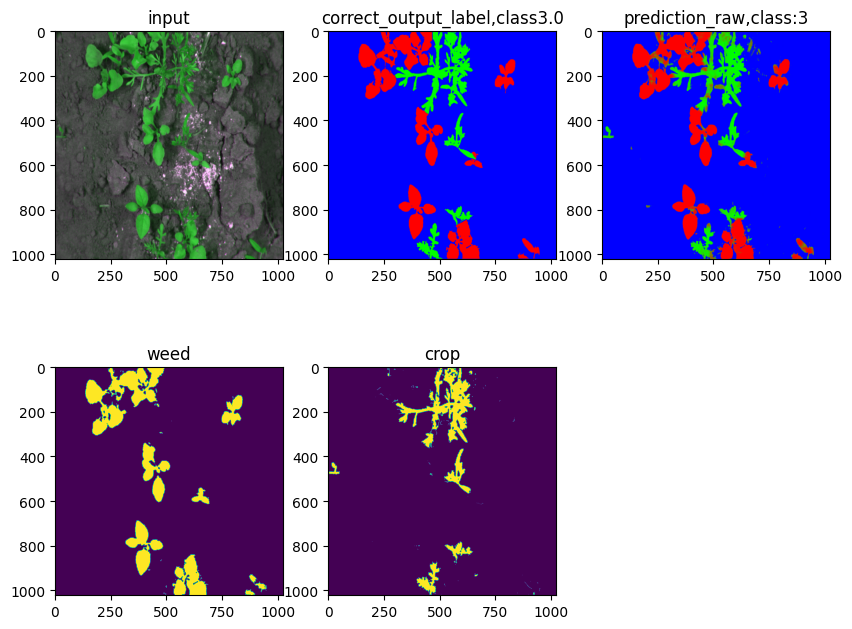

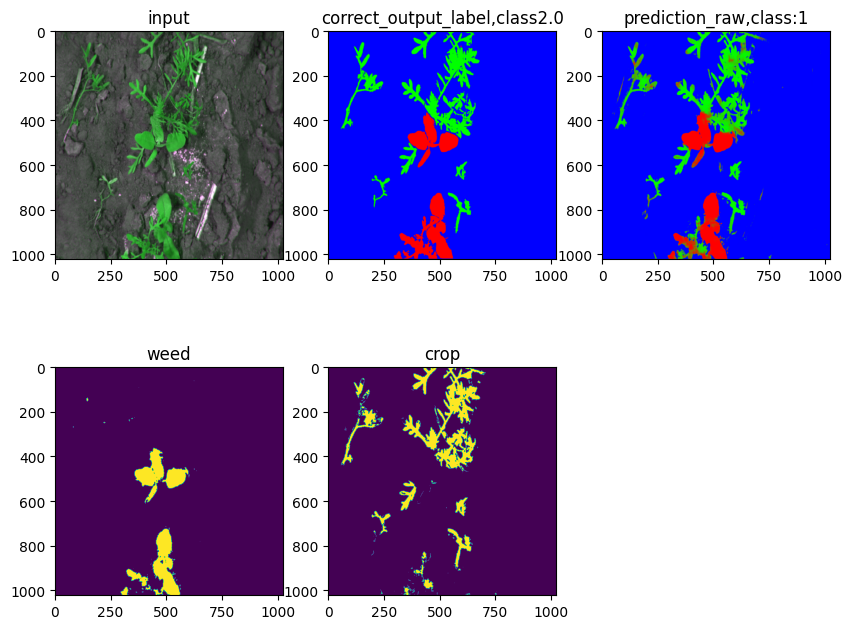

In [32]:
classes_train=get_classes(train_x,train_y,is_test=False)

In [33]:
from sklearn.metrics import classification_report
print(classification_report(classes_test,w_c.loc[test_indx-1]["classes"]))

              precision    recall  f1-score   support

           0       0.88      1.00      0.93         7
           1       1.00      0.67      0.80         6
           2       1.00      0.83      0.91         6
           3       0.50      1.00      0.67         2

    accuracy                           0.86        21
   macro avg       0.84      0.88      0.83        21
weighted avg       0.91      0.86      0.86        21



In [34]:
from sklearn.metrics import classification_report
print(classification_report(classes_train,w_c.loc[train_indx-1]["classes"]))

              precision    recall  f1-score   support

           0       1.00      0.93      0.96        14
           1       0.91      0.77      0.83        13
           2       0.71      0.62      0.67         8
           3       0.56      1.00      0.71         5

    accuracy                           0.82        40
   macro avg       0.79      0.83      0.79        40
weighted avg       0.86      0.82      0.83        40



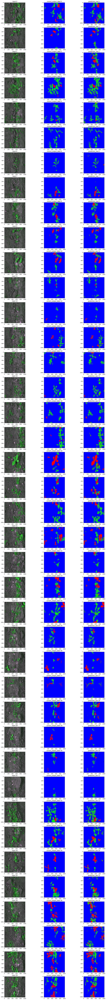

In [35]:
# change the value of n below to see different images in the train dataset
#n should be smaller than 20
v=0
plt.figure(figsize=(18,4*len(train_x)))
for i in range(len(train_x)):
  v=v+1
  plt.subplot(len(train_x),3,v)
  plt.title("input "+str(i))
  plt.imshow(train_x[i])
  v=v+1
  plt.subplot(len(train_x),3,v)
  plt.title("correct_output_label "+str(i))
  img = np.reshape(train_y[i, :],(dim,dim,3))
  plt.imshow(img)
  v=v+1
  prediction = model.predict(train_x[i:i+1])
  prediction = np.reshape(prediction,(dim,dim,3))
  plt.subplot(len(train_x),3,v)
  plt.title("prediction_raw "+str(i))
  plt.imshow(prediction)




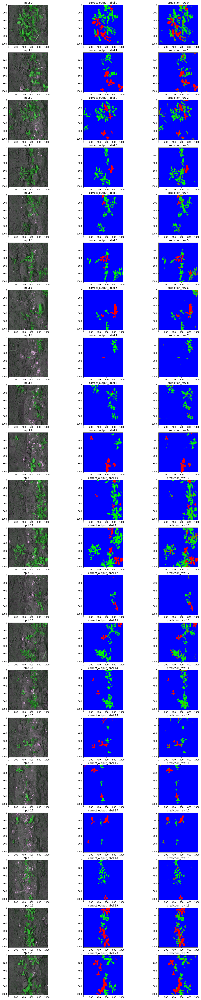

In [36]:
# change the value of n below to see different images in the test dataset
#n should be smaller than 20
v=0
plt.figure(figsize=(18,4*len(test_x)))
for i in range(len(test_x)):
  v=v+1
  plt.subplot(len(test_x),3,v)
  plt.title("input "+str(i))
  plt.imshow(test_x[i])
  v=v+1
  plt.subplot(len(test_x),3,v)
  plt.title("correct_output_label "+str(i))
  img = np.reshape(test_y[i, :],(dim,dim,3))
  plt.imshow(img)
  v=v+1
  prediction = model.predict(test_x[i:i+1])
  prediction = np.reshape(prediction,(dim,dim,3))
  plt.subplot(len(test_x),3,v)
  plt.title("prediction_raw "+str(i))
  plt.imshow(prediction)


